In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.offline import iplot
import plotly.graph_objs as go

In [2]:
df = pd.read_csv('Neighbourhood_Crime_Rates_Boundary_File_-1.csv')

In [3]:
df.head()

,OBJECTID,Neighbourhood,Hood_ID,Population,Assault_2014,Assault_2015,Assault_2016,Assault_2017,Assault_2018,Assault_2019,...,TheftOver_2015,TheftOver_2016,TheftOver_2017,TheftOver_2018,TheftOver_2019,TheftOver_AVG,TheftOver_CHG,TheftOver_Rate_2019,Shape__Area,Shape__Length
0,1,Yonge-St.Clair,97,12528,20,29,39,27,34,37,...,5,8,0,3,6,4.3,1.00,47.9,1.161315e+06,5873.270582
1,2,York University Heights,27,27593,271,296,361,344,357,370,...,46,37,39,38,28,36.3,-0.26,101.5,1.324666e+07,18504.777326
2,3,Lansing-Westgate,38,16164,44,80,68,85,75,72,...,5,5,11,6,11,7.0,0.83,68.1,5.346186e+06,11112.109625
3,4,Yorkdale-Glen Park,31,14804,106,136,174,161,175,209,...,14,26,23,20,29,22.5,0.45,195.9,6.038326e+06,10079.426920
4,5,Stonegate-Queensway,16,25051,88,71,76,95,87,82,...,8,4,6,7,4,6.0,-0.43,16.0,7.946202e+06,11853.189878


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 140 entries, 0 to 139
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   OBJECTID                 140 non-null    int64  
 1   Neighbourhood            140 non-null    object 
 2   Hood_ID                  140 non-null    int64  
 3   Population               140 non-null    int64  
 4   Assault_2014             140 non-null    int64  
 5   Assault_2015             140 non-null    int64  
 6   Assault_2016             140 non-null    int64  
 7   Assault_2017             140 non-null    int64  
 8   Assault_2018             140 non-null    int64  
 9   Assault_2019             140 non-null    int64  
 10  Assault_AVG              140 non-null    float64
 11  Assault_CHG              140 non-null    float64
 12  Assault_Rate_2019        140 non-null    float64
 13  AutoTheft_2014           140 non-null    int64  
 14  AutoTheft_2015           1

In [5]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
OBJECTID,140.0,7.050000e+01,4.055860e+01,1.000000,3.575000e+01,7.050000e+01,1.052500e+02,1.400000e+02
Hood_ID,140.0,7.050000e+01,4.055860e+01,1.000000,3.575000e+01,7.050000e+01,1.052500e+02,1.400000e+02
Population,140.0,1.951122e+04,1.003359e+04,6577.000000,1.201950e+04,1.674950e+04,2.385450e+04,6.591300e+04
Assault_2014,140.0,1.173500e+02,1.069690e+02,16.000000,5.375000e+01,8.500000e+01,1.412500e+02,7.380000e+02
Assault_2015,140.0,1.268857e+02,1.196135e+02,12.000000,5.725000e+01,9.200000e+01,1.522500e+02,8.260000e+02
Assault_2016,140.0,1.322000e+02,1.265010e+02,10.000000,5.750000e+01,9.700000e+01,1.662500e+02,8.880000e+02
Assault_2017,140.0,1.346071e+02,1.371681e+02,20.000000,5.875000e+01,9.400000e+01,1.595000e+02,9.050000e+02
Assault_2018,140.0,1.389357e+02,1.428838e+02,15.000000,5.875000e+01,9.350000e+01,1.675000e+02,9.100000e+02
Assault_2019,140.0,1.459000e+02,1.485005e+02,17.000000,6.200000e+01,9.950000e+01,1.720000e+02,9.160000e+02
Assault_AVG,140.0,1.326464e+02,1.289774e+02,18.500000,5.942500e+01,9.650000e+01,1.602000e+02,8.518000e+02


In [6]:
df.columns

Index(['OBJECTID', 'Neighbourhood', 'Hood_ID', 'Population', 'Assault_2014',
       'Assault_2015', 'Assault_2016', 'Assault_2017', 'Assault_2018',
       'Assault_2019', 'Assault_AVG', 'Assault_CHG', 'Assault_Rate_2019',
       'AutoTheft_2014', 'AutoTheft_2015', 'AutoTheft_2016', 'AutoTheft_2017',
       'AutoTheft_2018', 'AutoTheft_2019', 'AutoTheft_AVG', 'AutoTheft_CHG',
       'AutoTheft_Rate_2019', 'BreakandEnter_2014', 'BreakandEnter_2015',
       'BreakandEnter_2016', 'BreakandEnter_2017', 'BreakandEnter_2018',
       'BreakandEnter_2019', 'BreakandEnter_AVG', 'BreakandEnter_CHG',
       'BreakandEnter_Rate_2019', 'Homicide_2014', 'Homicide_2015',
       'Homicide_2016', 'Homicide_2017', 'Homicide_2018', 'Homicide_2019',
       'Homicide_AVG', 'Homicide_CHG', 'Homicide_Rate_2019', 'Robbery_2014',
       'Robbery_2015', 'Robbery_2016', 'Robbery_2017', 'Robbery_2018',
       'Robbery_2019', 'Robbery_AVG', 'Robbery_CHG', 'Robbery_Rate_2019',
       'TheftOver_2014', 'TheftOver_201

In [7]:
# Graphs for Each section of crime (Assault, AutoTheft, B&E, Homicide, Robbery, Theft) by year
assault_2014 = df['Assault_2014'].sum()
assault_2015 = df['Assault_2015'].sum()
assault_2016 = df['Assault_2016'].sum()
assault_2017 = df['Assault_2017'].sum()
assault_2018 = df['Assault_2018'].sum()
assault_2019 = df['Assault_2019'].sum()

index=[2014,2015,2016,2017,2018,2019]
assault_df = pd.DataFrame([assault_2014,assault_2015,assault_2016,assault_2017,assault_2018,assault_2019],columns = ['count'], index=index)

assault_df.reset_index(inplace = True)
assault_df.columns = ['Year', 'Count']

In [22]:
# Counts of Assaults (2014-2019)
px.bar(assault_df,x='Year',y='Count', title='Assaults Per Year')

In [11]:
import plotly.io as pio
pio.write_html(fig, file='assault.html', auto_open=True)

In [23]:
# Counts of AutoTheft (2014-2019)
auto_2014 = df['AutoTheft_2014'].sum()
auto_2015 = df['AutoTheft_2015'].sum()
auto_2016 = df['AutoTheft_2016'].sum()
auto_2017 = df['AutoTheft_2017'].sum()
auto_2018 = df['AutoTheft_2018'].sum()
auto_2019 = df['AutoTheft_2019'].sum()

index=[2014,2015,2016,2017,2018,2019]
AutoTheft_df = pd.DataFrame([auto_2014,auto_2015,auto_2016,auto_2017,auto_2018,auto_2019],columns = ['count'], index=index)

AutoTheft_df.reset_index(inplace = True)
AutoTheft_df.columns = ['Year', 'Count']

px.bar(AutoTheft_df, x='Year',y='Count',title='Auto Theft Per Year')

In [14]:
pio.write_html(fig, file='autotheft.html', auto_open=True)

In [24]:
# Counts of B&E (2014-2019)
be_2014 = df['BreakandEnter_2014'].sum()
be_2015 = df['BreakandEnter_2015'].sum()
be_2016 = df['BreakandEnter_2016'].sum()
be_2017 = df['BreakandEnter_2017'].sum()
be_2018 = df['BreakandEnter_2018'].sum()
be_2019 = df['BreakandEnter_2019'].sum()

index=[2014,2015,2016,2017,2018,2019]
be_df = pd.DataFrame([be_2014,be_2015,be_2016,be_2017,be_2018,be_2019],columns = ['count'], index=index)

be_df.reset_index(inplace = True)
be_df.columns = ['Year', 'Count']

px.bar(be_df,x='Year',y='Count',title='B&E Per Year')

In [16]:
pio.write_html(fig, file='b&e.html', auto_open=True)

In [25]:
# Counts of Homicides (2014-2019)
hom_2014 = df['Homicide_2014'].sum()
hom_2015 = df['Homicide_2015'].sum()
hom_2016 = df['Homicide_2016'].sum()
hom_2017 = df['Homicide_2017'].sum()
hom_2018 = df['Homicide_2018'].sum()
hom_2019 = df['Homicide_2019'].sum()

index=[2014,2015,2016,2017,2018,2019]
hom_df = pd.DataFrame([hom_2014,hom_2015,hom_2016,hom_2017,hom_2018,hom_2019],columns = ['count'], index=index)

hom_df.reset_index(inplace = True)
hom_df.columns = ['Year', 'Count']

px.bar(hom_df,x='Year',y='Count',title='Homicides Per Year')

In [18]:
pio.write_html(fig, file='homicide.html', auto_open=True)

In [26]:
# Counts of Homicides (2014-2019)
rob_2014 = df['Robbery_2014'].sum()
rob_2015 = df['Robbery_2015'].sum()
rob_2016 = df['Robbery_2016'].sum()
rob_2017 = df['Robbery_2017'].sum()
rob_2018 = df['Robbery_2018'].sum()
rob_2019 = df['Robbery_2019'].sum()

index=[2014,2015,2016,2017,2018,2019]
rob_df = pd.DataFrame([rob_2014,rob_2015,rob_2016,rob_2017,rob_2018,rob_2019],columns = ['count'], index=index)

rob_df.reset_index(inplace = True)
rob_df.columns = ['Year', 'Count']

px.bar(rob_df,x='Year',y='Count',title='Robberies Per Year')

In [20]:
pio.write_html(fig, file='robberies.html', auto_open=True)

In [27]:
# Counts of Homicides (2014-2019)
theft_2014 = df['TheftOver_2014'].sum()
theft_2015 = df['TheftOver_2015'].sum()
theft_2016 = df['TheftOver_2016'].sum()
theft_2017 = df['TheftOver_2017'].sum()
theft_2018 = df['TheftOver_2018'].sum()
theft_2019 = df['TheftOver_2019'].sum()

index=[2014,2015,2016,2017,2018,2019]
theft_df = pd.DataFrame([theft_2014,theft_2015,theft_2016,theft_2017,theft_2018,theft_2019],columns = ['count'], index=index)

theft_df.reset_index(inplace = True)
theft_df.columns = ['Year', 'Count']

px.bar(theft_df,x='Year',y='Count',title='Theft Per Year')

Text(0.5, 1.0, 'Robberies Per Year')

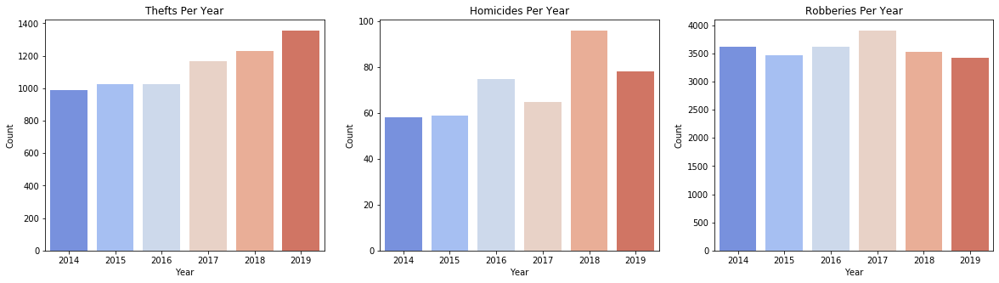

In [47]:
fig, axes = plt.subplots(1,3, figsize=(20,5))
sns.barplot(x='Year',y='Count',data=theft_df, ax=axes[0], palette='coolwarm').set_title('Thefts Per Year')
sns.barplot(x='Year',y='Count',data=hom_df, ax=axes[1], palette='coolwarm').set_title('Homicides Per Year')
sns.barplot(x='Year',y='Count',data=rob_df, ax=axes[2], palette='coolwarm').set_title('Robberies Per Year')

In [22]:
pio.write_html(fig, file='theft.html', auto_open=True)

In [9]:
# Neighbourhood Vs. Population Vs. Assault
import plotly.express as px
crime_list = ['Assault_AVG','AutoTheft_AVG','BreakandEnter_AVG','Homicide_AVG','Robbery_AVG','TheftOver_AVG']
nbh_assault = px.scatter(df, x="Neighbourhood", y=crime_list[0], color='Population',title='Neighbourhood Vs. Population Vs. Crime')
#pio.write_html(nbh_assault, file='nbh_assault.html', auto_open=True)
nbh_assault

In [10]:
nbh_auto = px.scatter(df, x="Neighbourhood", y=crime_list[1],color='Population',title='Neighbourhood Vs. Population Vs. Crime')
nbh_auto
#pio.write_html(nbh_auto, file = 'nbh_auto.html', auto_open=True)

In [11]:
nbh_be = px.scatter(df, x="Neighbourhood", y=crime_list[2], color='Population',title='Neighbourhood Vs. Population Vs. Crime')
nbh_be
#pio.write_html(nbh_be, file = 'nbh_be.html', auto_open=True)

In [12]:
nbh_homicide = px.scatter(df, x="Neighbourhood", y=crime_list[3], color='Population',title='Neighbourhood Vs. Population Vs. Crime')
nbh_homicide
#pio.write_html(nbh_homicide, file = 'nbh_homicide.html', auto_open=False)

In [13]:
nbh_robbery = px.scatter(df, x="Neighbourhood", y=crime_list[4], color='Population',title='Neighbourhood Vs. Population Vs. Crime')
nbh_robbery
#pio.write_html(nbh_robbery, file = 'nbh_robbery.html', auto_open=False)

In [14]:
nbh_theft = px.scatter(df, x="Neighbourhood", y=crime_list[5], color='Population',title='Neighbourhood Vs. Population Vs. Crime')
nbh_theft
#pio.write_html(nbh_theft, file = 'nbh_theft.html', auto_open=False)

In [17]:
pt = pd.pivot_table(df,index='Neighbourhood',values=['Assault_AVG','AutoTheft_AVG','Robbery_AVG','BreakandEnter_AVG','Homicide_AVG','TheftOver_AVG'])
pt.reset_index(inplace=True)
pt

,Neighbourhood,Assault_AVG,AutoTheft_AVG,BreakandEnter_AVG,Homicide_AVG,Robbery_AVG,TheftOver_AVG
0,Agincourt North,74.8,29.7,53.5,0.2,30.2,4.7
1,Agincourt South-Malvern West,117.8,36.7,79.8,0.2,27.3,13.3
2,Alderwood,36.3,16.2,24.7,0.2,6.8,6.8
3,Annex,246.3,22.0,147.5,0.5,40.8,29.5
4,Banbury-Don Mills,80.5,21.8,73.2,0.0,15.0,10.3
...,...,...,...,...,...,...,...
135,Wychwood,70.2,13.2,34.0,0.3,13.8,2.3
136,Yonge-Eglinton,75.8,9.0,28.0,0.3,19.5,4.8
137,Yonge-St.Clair,31.0,4.3,23.3,0.0,5.7,4.3
138,York University Heights,333.2,106.3,113.2,0.8,75.8,36.3


In [18]:
assault = pt['Assault_AVG'].sum()
auto = pt['AutoTheft_AVG'].sum()
be = pt['BreakandEnter_AVG'].sum()
homi = pt['Homicide_AVG'].sum()
rob = pt['Robbery_AVG'].sum()
theft = pt['TheftOver_AVG'].sum()

crime_df = pd.DataFrame([assault,auto,be,homi,rob,theft], columns = ['Count'], index = ['Assault','AutoTheft','B&E','Homicides','Robbery','Theft'])
crime_df.reset_index(inplace=True)
crime_df.columns = ['Crime','Count']

In [19]:
pie = px.pie(crime_df,values='Count',names='Crime')
pie

In [27]:
import plotly.io as pio
pio.write_html(pie, file='pie.html', auto_open=True)

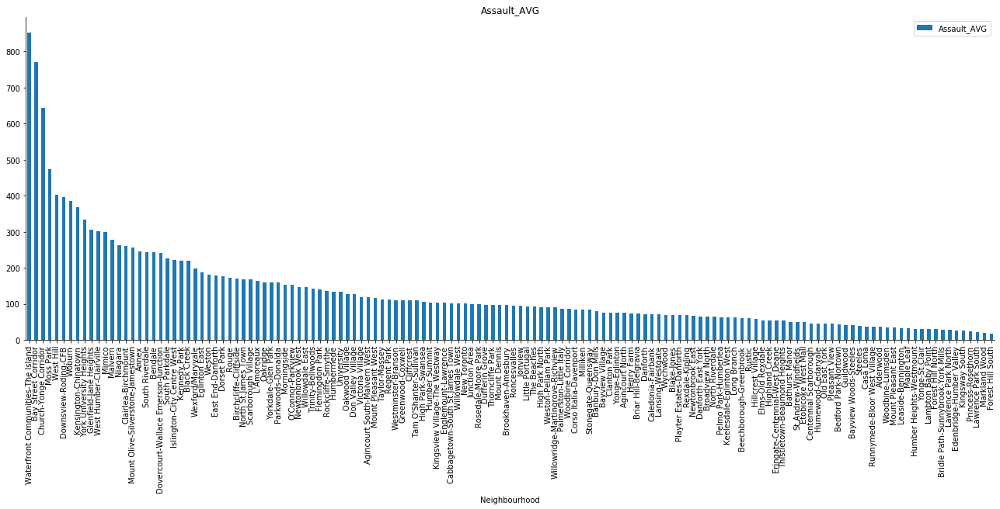

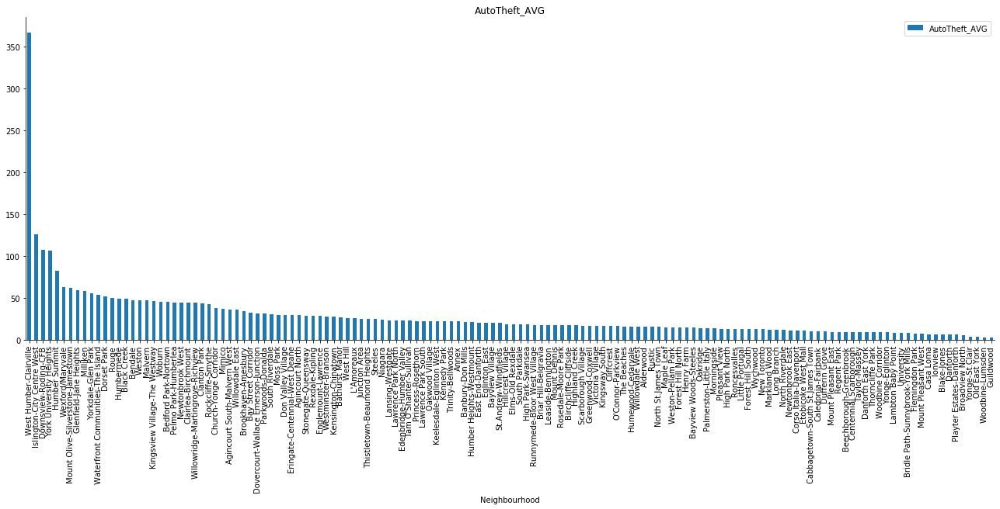

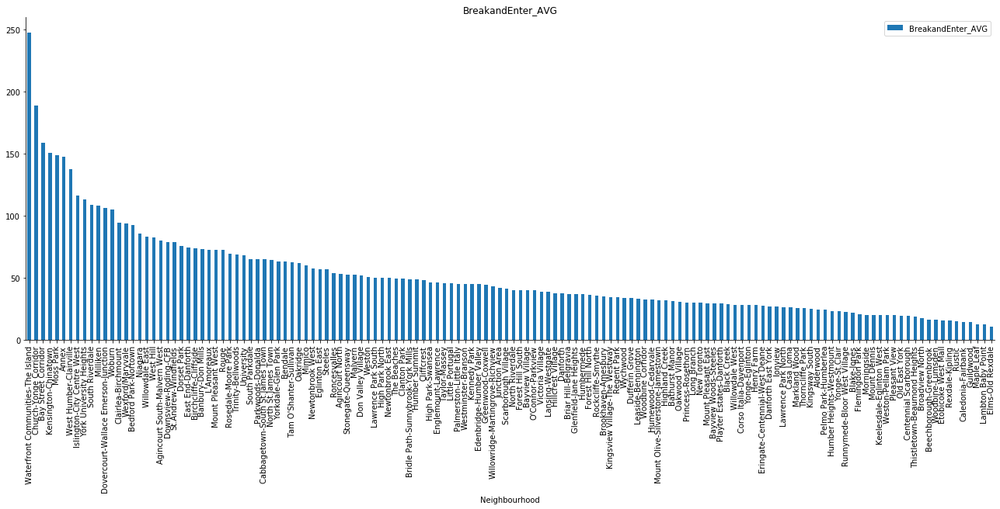

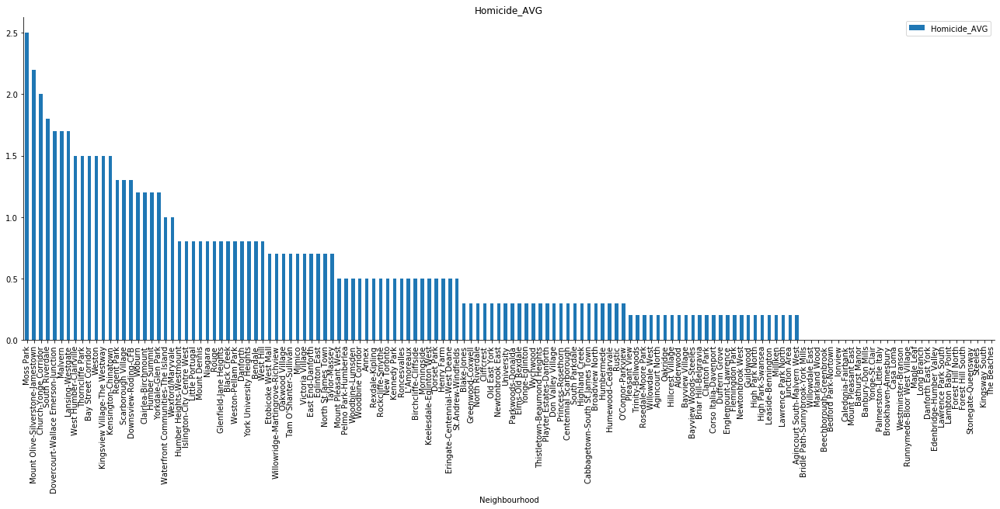

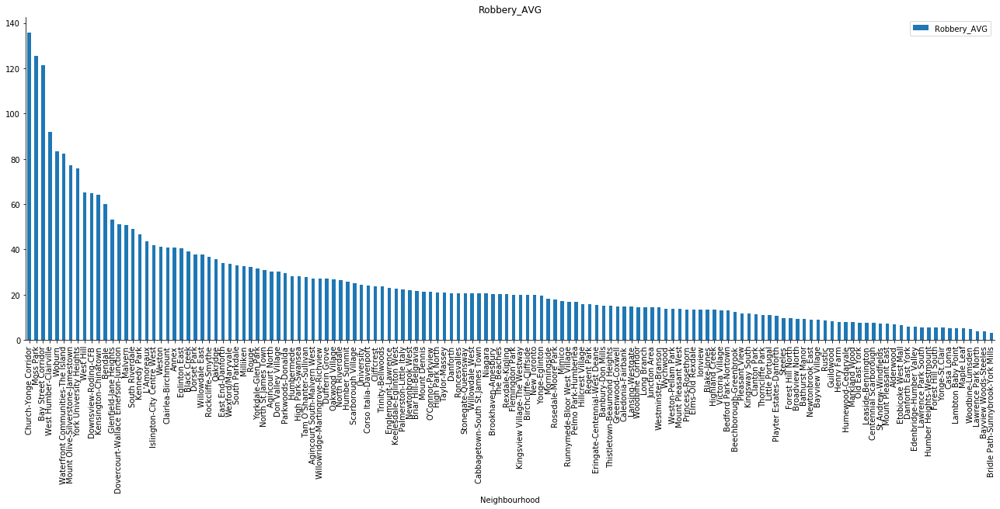

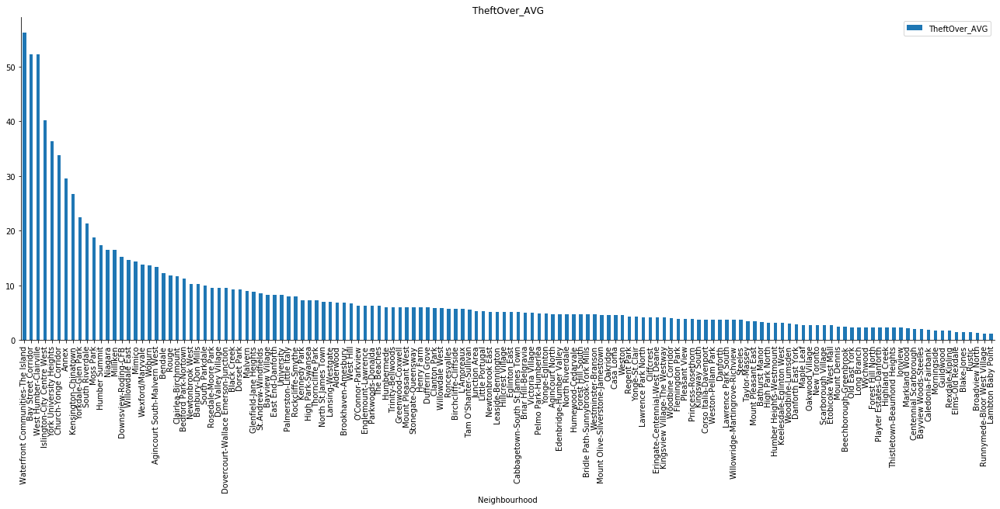

In [56]:
# Graphs for the average crime in different neighbourhoods
crime_list = ['Assault_AVG','AutoTheft_AVG','BreakandEnter_AVG','Homicide_AVG','Robbery_AVG','TheftOver_AVG']
for i in crime_list:
  pd.pivot_table(df,index='Neighbourhood',values = i).sort_values(by=i,ascending = False).plot(kind='bar',figsize=(18,9))
  plt.tight_layout()
  sns.despine()
  plt.title(i)
  plt.savefig(i+'.png')

# Crimes by year by each neighbourhood

In [40]:
df.columns

Index(['OBJECTID', 'Neighbourhood', 'Hood_ID', 'Population', 'Assault_2014',
       'Assault_2015', 'Assault_2016', 'Assault_2017', 'Assault_2018',
       'Assault_2019', 'Assault_AVG', 'Assault_CHG', 'Assault_Rate_2019',
       'AutoTheft_2014', 'AutoTheft_2015', 'AutoTheft_2016', 'AutoTheft_2017',
       'AutoTheft_2018', 'AutoTheft_2019', 'AutoTheft_AVG', 'AutoTheft_CHG',
       'AutoTheft_Rate_2019', 'BreakandEnter_2014', 'BreakandEnter_2015',
       'BreakandEnter_2016', 'BreakandEnter_2017', 'BreakandEnter_2018',
       'BreakandEnter_2019', 'BreakandEnter_AVG', 'BreakandEnter_CHG',
       'BreakandEnter_Rate_2019', 'Homicide_2014', 'Homicide_2015',
       'Homicide_2016', 'Homicide_2017', 'Homicide_2018', 'Homicide_2019',
       'Homicide_AVG', 'Homicide_CHG', 'Homicide_Rate_2019', 'Robbery_2014',
       'Robbery_2015', 'Robbery_2016', 'Robbery_2017', 'Robbery_2018',
       'Robbery_2019', 'Robbery_AVG', 'Robbery_CHG', 'Robbery_Rate_2019',
       'TheftOver_2014', 'TheftOver_201

C:\Users\User\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



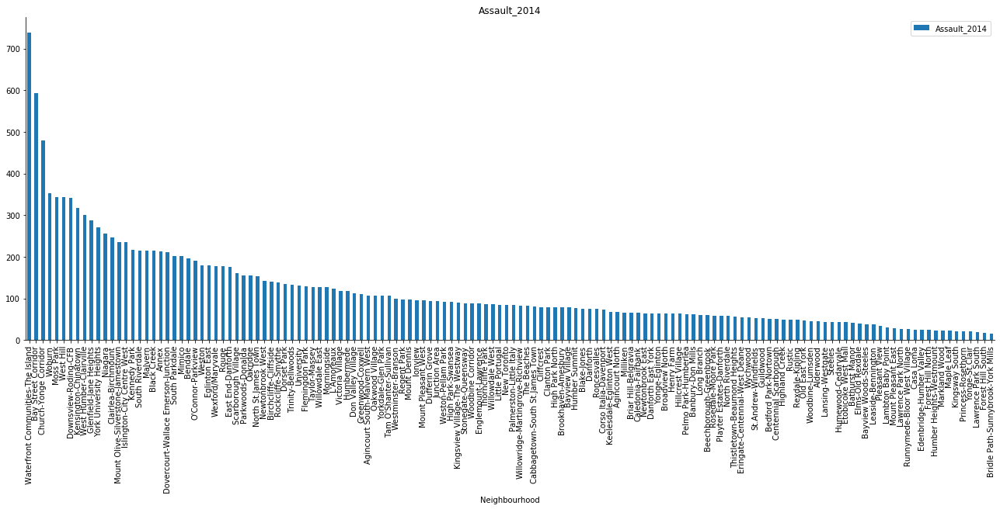

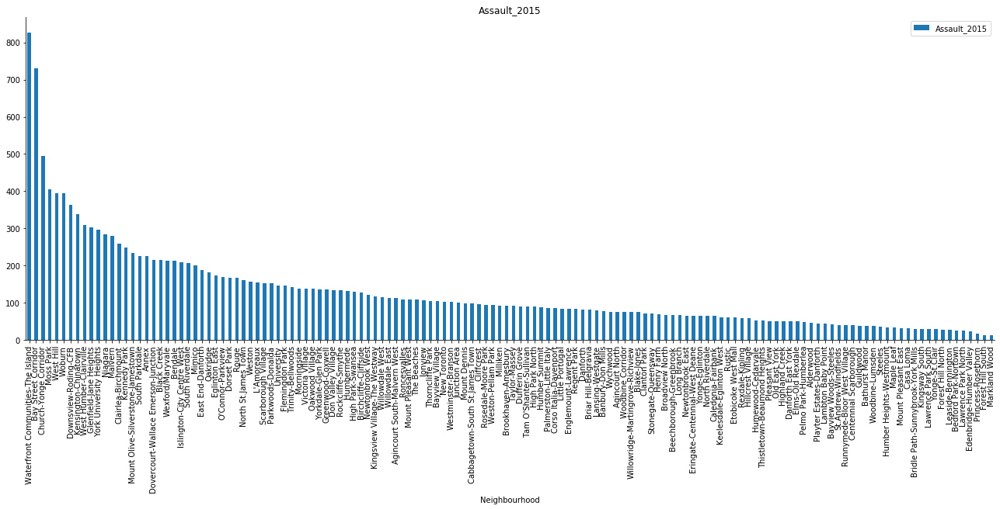

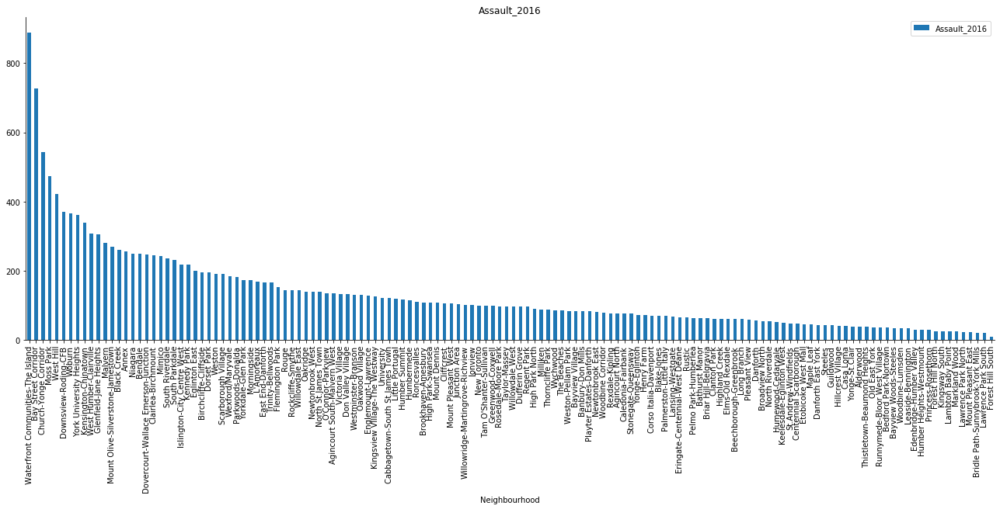

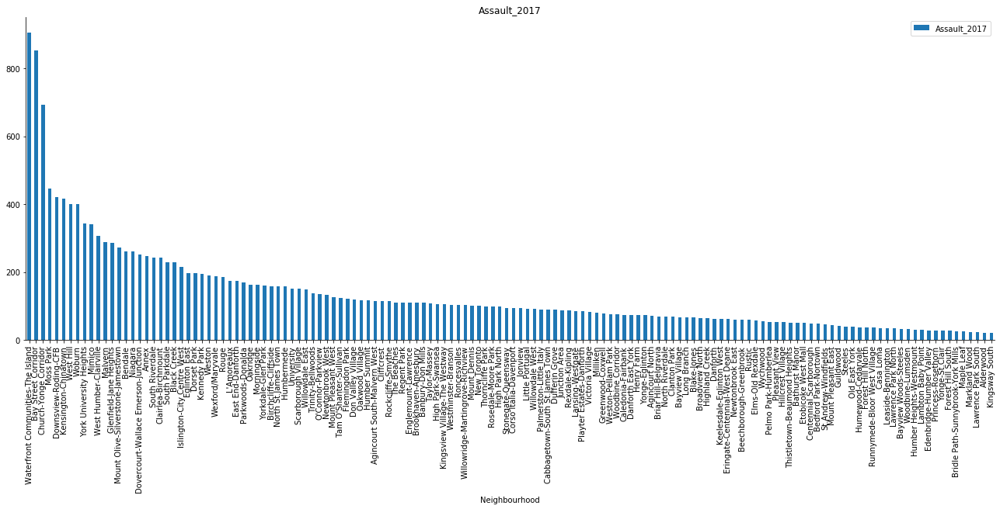

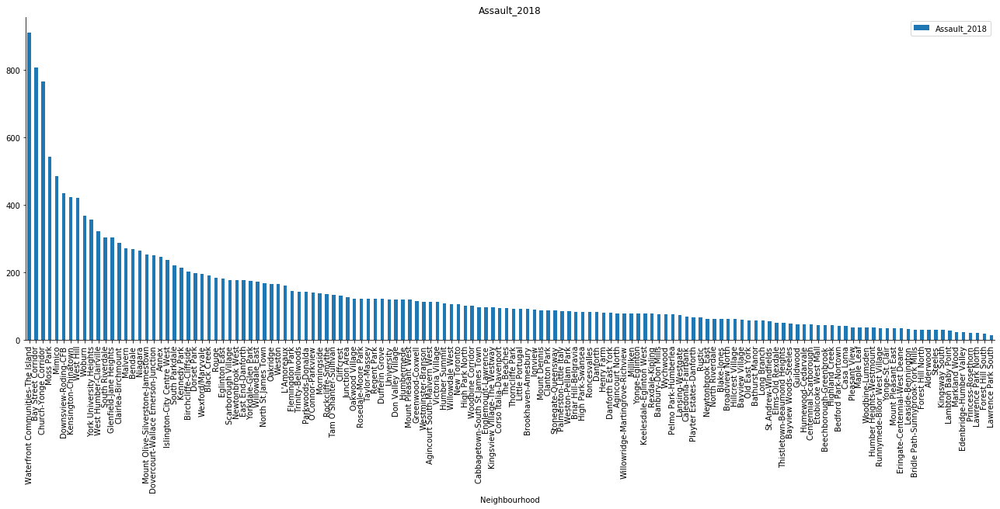

...

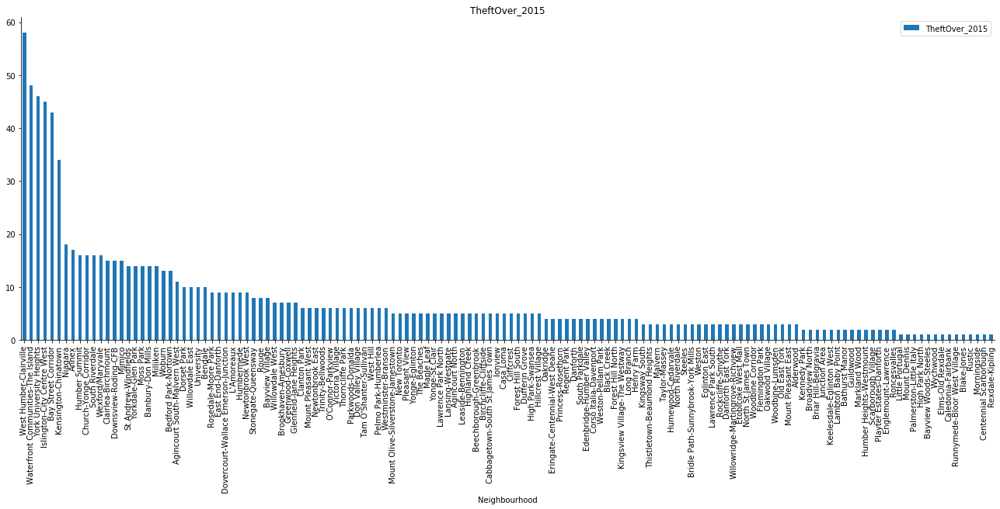

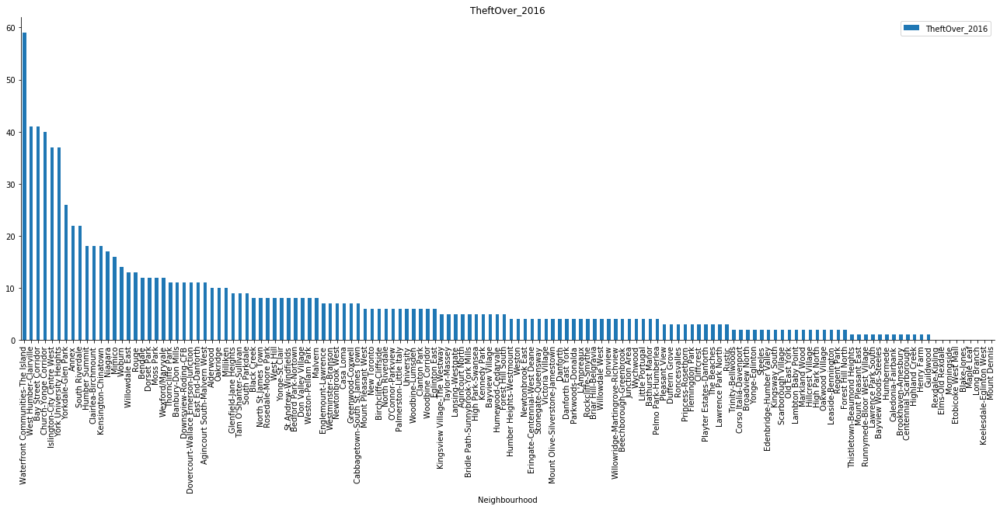

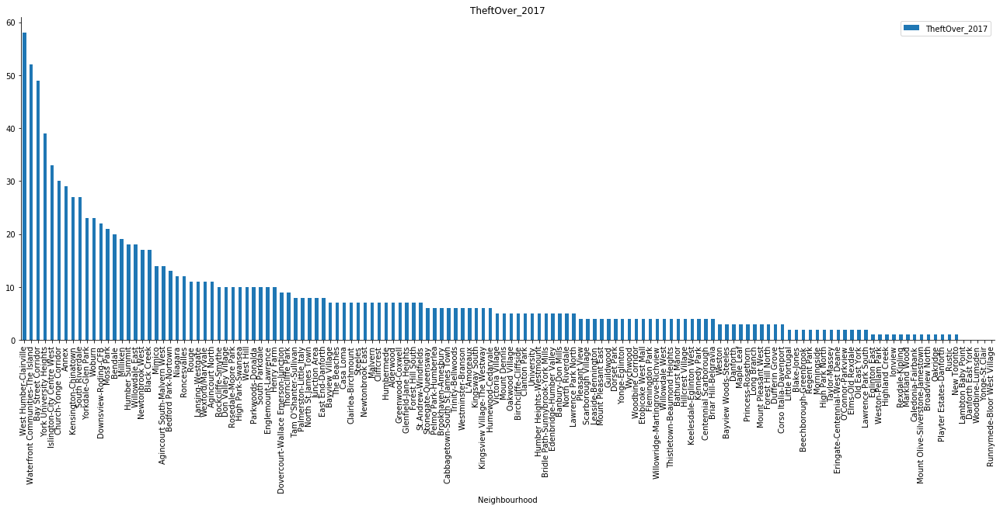

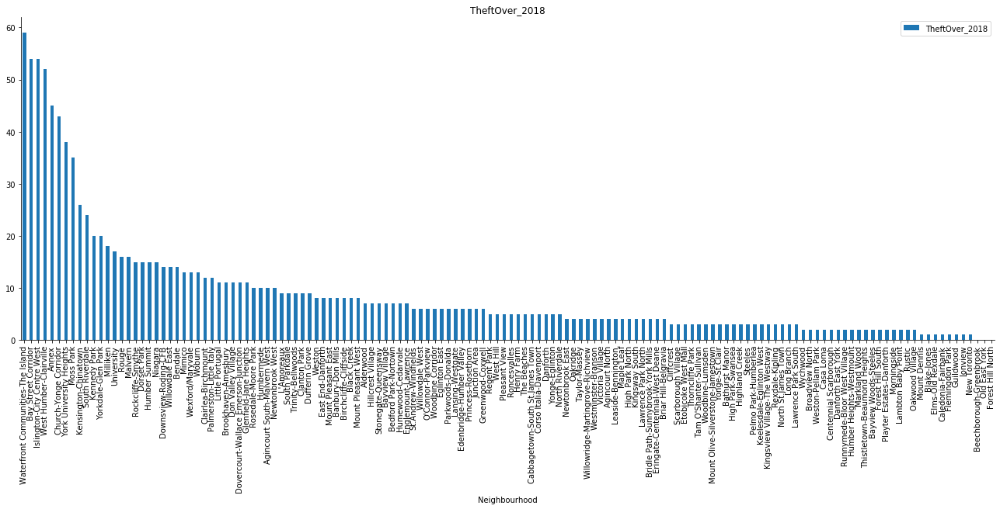

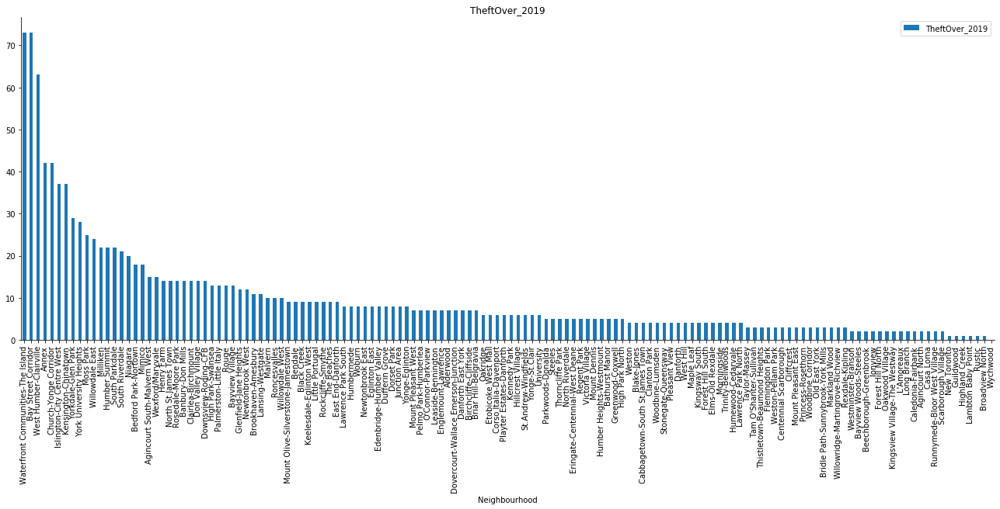

In [57]:
crime_list = ['Assault_2014','Assault_2015', 'Assault_2016', 'Assault_2017', 'Assault_2018','Assault_2019', 
       'AutoTheft_2014', 'AutoTheft_2015', 'AutoTheft_2016', 'AutoTheft_2017','AutoTheft_2018', 'AutoTheft_2019', 
       'BreakandEnter_2014', 'BreakandEnter_2015','BreakandEnter_2016', 'BreakandEnter_2017', 'BreakandEnter_2018','BreakandEnter_2019', 
       'Homicide_2014', 'Homicide_2015','Homicide_2016', 'Homicide_2017', 'Homicide_2018', 'Homicide_2019',
       'Robbery_2014','Robbery_2015', 'Robbery_2016', 'Robbery_2017', 'Robbery_2018','Robbery_2019',
       'TheftOver_2014', 'TheftOver_2015', 'TheftOver_2016', 'TheftOver_2017','TheftOver_2018', 'TheftOver_2019']
for i in crime_list:
  pd.pivot_table(df,index='Neighbourhood',values = i).sort_values(by=i,ascending = False).plot(kind='bar',figsize=(18,9))
  plt.tight_layout()
  sns.despine()
  plt.title(i)
  plt.savefig(i+'.png')

In [32]:
import folium
m = folium.Map(location=[43.6532, -79.3832])
toronto = 'Neighbourhood_Crime_Rates_(Boundary_File)_.geojson'

In [33]:
choropleth = folium.Choropleth(
    geo_data=toronto,
    data=df,
    columns=['Neighbourhood','Assault_AVG'],
    key_on = 'feature.properties.Neighbourhood',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Assaults by Neighbourhood',
).add_to(m)

choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['Neighbourhood']))
m

In [34]:
m.save('assault_toronto.html')

In [35]:
m = folium.Map(location=[43.6532, -79.3832])
toronto = 'Neighbourhood_Crime_Rates_(Boundary_File)_.geojson'

In [36]:
choropleth = folium.Choropleth(
    geo_data=toronto,
    data=df,
    columns=['Neighbourhood','AutoTheft_AVG'],
    key_on = 'feature.properties.Neighbourhood',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Auto Theft by Neighbourhood',
).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['Neighbourhood']))
m

In [37]:
m.save('autotheft_toronto.html')

In [38]:
m = folium.Map(location=[43.6532, -79.3832])
toronto = 'Neighbourhood_Crime_Rates_(Boundary_File)_.geojson'

In [39]:
choropleth = folium.Choropleth(
    geo_data=toronto,
    data=df,
    columns=['Neighbourhood','BreakandEnter_AVG'],
    key_on = 'feature.properties.Neighbourhood',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='B&E by Neighbourhood',
).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['Neighbourhood']))
m

In [40]:
m.save('B&E_toronto.html')

In [41]:
m = folium.Map(location=[43.6532, -79.3832])
toronto = 'Neighbourhood_Crime_Rates_(Boundary_File)_.geojson'

In [42]:
choropleth = folium.Choropleth(
    geo_data=toronto,
    data=df,
    columns=['Neighbourhood','Homicide_AVG'],
    key_on = 'feature.properties.Neighbourhood',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Homicides by Neighbourhood',
).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['Neighbourhood']))
m

In [43]:
m.save('homicide_toronto.html')

In [44]:
m = folium.Map(location=[43.6532, -79.3832])
toronto = 'Neighbourhood_Crime_Rates_(Boundary_File)_.geojson'

In [45]:
choropleth = folium.Choropleth(
    geo_data=toronto,
    data=df,
    columns=['Neighbourhood','Robbery_AVG'],
    key_on = 'feature.properties.Neighbourhood',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Robberies by Neighbourhood',
).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['Neighbourhood']))
m

In [46]:
m.save('robbery_toronto.html')

In [47]:
m = folium.Map(location=[43.6532, -79.3832])
toronto = 'Neighbourhood_Crime_Rates_(Boundary_File)_.geojson'

In [48]:
choropleth = folium.Choropleth(
    geo_data=toronto,
    data=df,
    columns=['Neighbourhood','TheftOver_AVG'],
    key_on = 'feature.properties.Neighbourhood',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Theft by Neighbourhood',
).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['Neighbourhood']))
m

In [49]:
m.save('theft_toronto.html')